In [73]:
import pandas as pd
import numpy as np
import re

In [74]:
pd.set_option('display.max_colwidth',None)
pd.set_option('display.max_rows',None)
pd.set_option('display.max_columns',None)

In [75]:
df = pd.read_csv("gurgaon_properties_cleaned_v1.csv")

In [76]:

df.sample()

,sector,property_type,society,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features
2960,sector 106,flat,paras dews,1.42,6029.0,2355.0,Super Built up area 2355(218.79 sq.m.),4,6,3+,servant room,11.0,North-East,1 to 5 Year Old,"['MG Road Metro Station', 'NeoSquare Shopping Mall', 'Dwarka Expressway', 'Glorious World School', 'DPG Institute of Technology', 'Chirag Hospital', 'Indira Gandhi International Airport', 'Gurgaon', 'Country Inn & Suites by Radisson', 'SkyJumper Trampoline Park', 'Hamoni Golf Camp']",[],"['Centrally Air Conditioned', 'Security / Fire Alarm', 'Power Back-up', 'Feng Shui / Vaastu Compliant', 'Private Garden / Terrace', 'Intercom Facility', 'Lift(s)', 'High Ceiling Height', 'Maintenance Staff', 'False Ceiling Lighting', 'Water Storage', 'Separate entry for servant room', 'No open drainage around', 'Internet/wi-fi connectivity', 'Recently Renovated', 'Visitor Parking', 'Swimming Pool', 'Park', 'Security Personnel', 'Airy Rooms', 'Rain Water Harvesting', 'Water softening plant', 'Shopping Centre', 'Fitness Centre / GYM', 'Club house / Community Center']"


In [77]:
# areaWithType, additionalRoom, agePossession, furnishDetails, features 

## 1.areaWithType

In [79]:
df.columns

Index(['sector', 'property_type', 'society', 'price', 'price_per_sqft', 'area',
       'areaWithType', 'bedRoom', 'bathroom', 'balcony', 'additionalRoom',
       'floorNum', 'facing', 'agePossession', 'nearbyLocations',
       'furnishDetails', 'features'],
      dtype='object')

In [80]:
df[["area","areaWithType"]].sample(5)

,area,areaWithType
1571,1300.05,Plot area 1300(120.77 sq.m.)
3618,1631.00,Super Built up area 2779(258.18 sq.m.)Built Up area: 2204.25 sq.ft. (204.78 sq.m.)Carpet area: 1631.07 sq.ft. (151.53 sq.m.)
2745,602.00,Super Built up area 602(55.93 sq.m.)Built Up area: 598 sq.ft. (55.56 sq.m.)Carpet area: 546 sq.ft. (50.73 sq.m.)
2806,2400.00,Built Up area: 2400 (222.97 sq.m.)
1064,2965.00,Super Built up area 2802(260.31 sq.m.)Built Up area: 2225.56 sq.ft. (206.76 sq.m.)


In [81]:
# area column is not consistent for different flat it gives different values (for some cases it has super built up area ,
# for some cases it has carpet area and in some cases it has built up ares) so area colm ius not reliabel
# this type of mess is happen because lots of properties are added by the brokers on the website

In [82]:
# create the new three colm from areaWithType 

# This function extracts the Super Built up area
def get_super_built_up_area(text):
    match = re.search(r'Super Built up area (\d+\.?\d*)', text)
    if match:
        return float(match.group(1))
    return None

In [83]:
# "Super Built up area " → exact text must appear.
# (\d+\.?\d*) → number after it:
# \d+ → one or more digits (mandatory)
# \.? → optional decimal point
# \d* → zero or more digits after decimal
# () → capture group, so number can be extracted using .group(1)

In [84]:
# This function extracts the Built Up area or Carpet area
def get_area(text, area_type):
    match = re.search(area_type + r'\s*:\s*(\d+\.?\d*)', text)
    if match:
        return float(match.group(1))
    return None

In [85]:
# area_type → matches the literal string (like "Built Up area")
# \s* → zero or more spaces
# : → literal colon
# \s* → zero or more spaces after colon
# (\d+\.?\d*) → number (integer or decimal) captured as group 1

In [86]:
# This function checks if the area is provided in sq.m. and converts it to sqft if needed
def convert_to_sqft(text, area_value):
    if area_value is None:
        return Non
    match = re.search(r'{} \((\d+\.?\d*) sq.m.\)'.format(area_value), text)
    if match:
        sq_m_value = float(match.group(1))
        return sq_m_value * 10.7639  # conversion factor from sq.m. to sqft
    return area_value

In [87]:
# Extract Super Built up area and convert to sqft if needed

df["super_built_up_area"] = df["areaWithType"].apply(lambda x: get_super_built_up_area(x))
df["super_built_up_area"] = df.apply(lambda x: convert_to_sqft(x['areaWithType'], x['super_built_up_area']), axis=1)

df["built_up_area"] = df["areaWithType"].apply(lambda x : get_area(x,"Built Up area"))
df["built_up_area"] = df.apply(lambda x: convert_to_sqft(x['areaWithType'],x['built_up_area']),axis=1)

df["carpet_area"] = df.apply(lambda x: get_area(x['areaWithType'], "Carpet area"),axis = 1)
df["carpet_area"] = df.apply(lambda x: convert_to_sqft(x['areaWithType'],x["carpet_area"]),axis = 1)
                                               

In [88]:
df.sample(5)

,sector,property_type,society,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features,super_built_up_area,built_up_area,carpet_area
478,sector 28,house,housing board colony,5.50,30556.0,1799.97,Plot area 200(167.23 sq.m.),4,3,3,"pooja room,others",2.0,North,10+ Year Old,"['Mg road metro station', 'Iffco chowk metro station', 'Arya Samaj Mandir', 'Jain Bhawan', 'Axis bank ATM', 'Punjab national bank ATM', 'Standard chartered ATM', 'Kotak mahindra bank ATM', 'Icici bank ATM', 'Sidhesh Hospital Gurgaon', 'Lord Krishna Hospital', 'Uma Sanjeevani Health Centre And Hospital', 'Privat Hospital', 'Umkal Hospital', 'Sitaram Bhartia', 'Surgi Center Clinic', 'Divine Look Clinic Centre 1', 'Religare Wellness', '98.4', 'Guardian', 'DT Cinemas', 'PVR Metropolitan', 'PVR Cinames', 'PVR Cinames', 'DT Cinemas', 'Indusind bank', 'Abn amro bank', 'Lord krishna bank', 'Hdfc bank', 'Kotak mahindra bank', 'Hsbc bank', 'Axis bank', 'Axis bank', 'NutrioBox Gurugram', 'Barbecue Grill', 'Pan Bangkok', 'Dighent cafe', 'Fat', 'Nowhere Brewpub and cafe', 'Belgian Waffle', 'Drunken Monkey', 'Blue Tokai Coffee Roasters', 'CCD', 'Starbucks', 'Pizza Hut', 'Food Court', 'American Montessori', 'Bahrisons library']","['1 Exhaust Fan', '1 Chimney', '1 Modular Kitchen', '3 Wardrobe', 'No AC', 'No Bed', 'No Curtains', 'No Dining Table', 'No Fan', 'No Geyser', 'No Light', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Washing Machine', 'No Water Purifier']","['Water Storage', 'Park', 'Rain Water Harvesting']",NaN,NaN,NaN
1157,sector 7,house,independent,6.50,15046.0,4320.09,Plot area 480(401.34 sq.m.),3,2,3+,not available,NaN,Na,10+ Year Old,"['Geeta Nursing Home Gurgaon', 'Chiranjiv Hospital', 'Taneja Hospital', 'Dr. Madan Clinic', 'Pearl Dental Clinic', 'Swastik Maternity and Medical Centre', 'Dev Man Kathuria Clinic', 'Ravi Clinic and Health Care Centre', 'Aryan Hospital', 'Bindal Clinic', 'M.S Hospital', 'My Care Clinic', 'D.R. Rajnis Gupta Clinic', 'Satyam Hospital Gurgaon', 'Triveni Hospital Gurgaon', 'Dr. Ashok Jain', 'Sparsh Hospital Gurgaon', 'Bhatnagar Maternity and Nursing Home', 'Shiv Mahima Patient Care Bureau', 'Shri Gobind Hospital', 'Gurgaon Eye Centre', 'Dr. Ajay S. Gupta Clinic', 'Lal Superspeciality Hospital', 'Dr. Sarvejeet Singh', 'Centre For Sight Gurgaon New Railway Road', 'Kidney Clinic', 'Kharbanda Maternity and Nursing Home', 'Gupta Hospital Gurgaon', 'Navjeevan Hospital and Maternity Centre', 'Dentecare - Multispeciality Dental Clinic', 'Lall Eye Care Centre', 'Om Charitable Dental & Implant Centre', 'Lalit Dental Care', 'Lall Nursing and Maternity Home', 'Tirath Ram Hospitals Pvt Ltd', 'Ankur Clinic and Maternity Home', 'M Goel Hospital', 'Shubham Hospital Gurgaon', 'Verma E.N.T. Hospital', 'Sethi Hospital Gurgaon', 'Nova Care Clinic', 'Dental Health Centre', 'Rajiv Memorial Eye Infirmary Jacobpura', 'Pasricha Hospital and Maternity Home', 'Sharma Hospital Gurgaon', 'State bank of india', 'Hdfc bank', 'Pizza Hut', 'St. Michaels Sr. Sec. School', 'Dronacharya Government College']",[],['Private Garden / Terrace'],NaN,NaN,NaN
720,sector 57,house,independent,3.50,21605.0,1620.00,Plot area 180(150.5 sq.m.),4,4,3+,store room,3.0,South,10+ Year Old,"['Radhakrishna Shani Mandir', 'Sanatan Dharm Mandir', 'State bank ATM', 'Icici bank ATM', 'Icici bank ATM', 'Citi bank ATM', 'Anand Hospital Gurgaon', 'Kriti Hospital', 'Surgicare Hospital Gurgaon', 'pracksht hospital', 'Vatsalya Clinic', 'Arunodaya Deseret Eye Hospital', 'Arihant Hospital', 'HUDA Office Complex', 'Wembley estate club', 'Medisca', 'Pernod Ricard Charitable Dispensary', 'Unitech', 'Heera Fuel Station', 'HCG CNG Station', 'Hdfc bank and atm', 'Hdfc bank', 'Kotak mahindra bank', 'Indusind bank', 'State bank of india', 'Axis bank', 'Icici bank', 'Hdfc bank', 'Hdfc bank & atm', '222', 'Pizza Hut', 'Madison and Pike', 'Wat-a-Burger', 'Burger Singh', 'Bikanerwala', 'Naivedyam Restau

In [89]:
df[['price','property_type','area','areaWithType','super_built_up_area','built_up_area','carpet_area']].sample(5)

,price,property_type,area,areaWithType,super_built_up_area,built_up_area,carpet_area
1961,1.22,flat,1765.0,Super Built up area 1765(163.97 sq.m.)Built Up area: 1665 sq.ft. (154.68 sq.m.)Carpet area: 1565 sq.ft. (145.39 sq.m.),1765.0,1665.0,1565.00
2128,3.08,house,2700.1,Built Up area: 2700 (250.84 sq.m.),NaN,2700.0,NaN
2429,1.36,flat,1537.0,Built Up area: 1535 (142.61 sq.m.),NaN,1535.0,NaN
1874,0.54,flat,845.0,Super Built up area 845.3(78.53 sq.m.)Carpet area: 528.3 sq.ft. (49.08 sq.m.),845.3,NaN,528.30
3329,1.50,flat,1815.0,Super Built up area 1815(168.62 sq.m.)Carpet area: 1071.33 sq.ft. (99.53 sq.m.),1815.0,NaN,1071.33


In [90]:
df.duplicated().sum()

122

In [91]:
# return the rows with the (super_built_up_area = NaN or built_up_area=NaN	or carpet_area=NaN)
df[(df["super_built_up_area"].isnull()) | (df["built_up_area"].isnull()) | (df["carpet_area"].isnull())]

,sector,property_type,society,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features,super_built_up_area,built_up_area,carpet_area
0,sector 95,flat,the roselia 2,0.45,6475.0,695.00,Built Up area: 695 (64.57 sq.m.)Carpet area: 595 sq.ft. (55.28 sq.m.),2,2,2,not available,19.0,North,undefined,NaN,NaN,NaN,NaN,695.000000,595.000000
1,sector 78,flat,umang monsoon breeze,1.20,6493.0,1848.00,Super Built up area 2250(209.03 sq.m.)Carpet area: 1848 sq.ft. (171.68 sq.m.),3,3,2,pooja room,8.0,Na,5 to 10 Year Old,"['Proposed Metro Station', 'Mahapal Shing', 'National Highway 8', 'IGD Primary Health Care', 'HDFC Bank', 'PCL Logistics', 'JW Mariott']","['1 Water Purifier', '1 Fridge', '5 Fan', '1 Exhaust Fan', '1 Dining Table', '3 Geyser', '1 Stove', '12 Light', '1 Modular Kitchen', '1 Chimney', '3 Wardrobe', '3 Bed', '1 Sofa', '1 Washing Machine', '1 Microwave', 'No AC', 'No Curtains', 'No TV']","['Piped-gas', 'Natural Light']",2250.00,NaN,1848.000000
2,manesar,flat,hsiidc sidco aravali,0.91,3516.0,2588.00,Super Built up area 2588(240.43 sq.m.)Built Up area: 1900 sq.ft. (176.52 sq.m.),3,3,3+,servant room,8.0,East,5 to 10 Year Old,"['Pooja Clinic', 'Dr. Sahil Clinic', 'Prakash Hospital', 'Shri Rade Clinic', 'Yadav Dental & Eye Care', 'Dental Hospital', 'Petrol pump Maitri motors', 'Petrol Pump', 'Petrol Pump Indian Oil', ""McDonald's"", ""McDonald's"", 'Rao Dhaba']","['6 Fan', '6 Light', 'No AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Geyser', 'No Modular Kitchen', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']","['Power Back-up', 'Lift(s)', 'Maintenance Staff', 'Park', 'Security Personnel']",2588.00,1900.000000,NaN
3,sector 108,flat,sobha city,3.35,13266.0,2525.00,Super Built up area 2072.9(192.58 sq.m.),3,4,2,not available,19.0,Na,0 to 1 Year Old,"['Dwarka Sector 21', 'Dwarka Expressway', 'Vasant Kunj', 'The Shikshiyan School', 'The NorthCap University', 'Rions Hospital', 'IGI Airport', 'Gurgaon', 'WTC Plaza', 'Luxus Haritma Resort', 'Fun N Food WaterPark', 'BSF Golf Course', 'Nehru Stadium']",NaN,"['Security / Fire Alarm', 'Feng Shui / Vaastu Compliant', 'Intercom Facility', 'Lift(s)', 'Water purifier', 'High Ceiling Height', 'Maintenance Staff', 'Water Storage', 'Visitor Parking', 'Swimming Pool', 'Park', 'Natural Light', 'Internet/wi-fi connectivity', 'Shopping Centre', 'Fitness Centre / GYM', 'Club house / Community Center']",2072.90,NaN,NaN
4,sector 108,flat,sobha city,1.90,13758.0,1381.00,Super Built up area 1381(128.3 sq.m.),2,2,2,not available,8.0,East,1 to 5 Year Old,"['Dwarka Sector 21', 'Dwarka Expressway', 'Vasant Kunj', 'The Shikshiyan School', 'The NorthCap University', 'Rions Hospital', 'IGI Airport', 'Gurgaon', 'WTC Plaza', 'Luxus Haritma Resort', 'Fun N Food WaterPark', 'BSF Golf Course', 'Nehru Stadium']",[],"['Power Back-up', 'Feng Shui / Vaastu Compliant', 'Intercom Facility', 'Lift(s)', 'High Ceiling Height', 'Maintenance Staff', 'False Ceiling Lighting', 'Separate entry for servant room', 'No open drainage around', 'Swimming Pool', 'Park', 'Internet/wi-fi connectivity', 'Shopping Centre', 'Fitness Centre / GYM', 'Waste Disposal', 'Rain Water Harvesting', 'Club house / Community Center', 'Water softening plant']",1381.00,NaN,NaN
5,sector 65,flat,m3m heights,2.15,15003.0,1433.00,Built Up area: 1433 (133.13 sq.m.),2,2,3+,not available,28.0,East,undefined,"['Rapid Metro Sector 56', 'M3m 65th Avenue Mall', 'Golf Course Extension Road', 'Gurgaon - Delhi Expy', 'DPS International School', 'DPG Institute of Technology', 'Park Hospital', 'Indira Gandhi International Airport', 'Lemon Tree Hotel', 'SkyJumper Trampoline Park', 'PVR Drive in Theatre']","['1 Light', 'No AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Fan', 'No Geyser', 'No Modular Kitchen', 'No Microwave', 'No Fridge', 'No S

In [92]:
# return the rows with the (super_built_up_area,built_up_area,carpet_area) not NaN

df[~((df["super_built_up_area"].isnull()) | (df["built_up_area"].isnull()) | (df["carpet_area"].isnull()))][['price','property_type','area','areaWithType','super_built_up_area','built_up_area','carpet_area']].shape

(534, 7)

In [93]:
df[df["areaWithType"].str.contains('Plot')][['price','property_type','area','areaWithType','super_built_up_area','built_up_area','carpet_area']]

,price,property_type,area,areaWithType,super_built_up_area,built_up_area,carpet_area
9,7.85,house,2700.01,Plot area 300(250.84 sq.m.),NaN,NaN,NaN
10,8.50,house,3239.95,Plot area 360(301.01 sq.m.),NaN,NaN,NaN
19,16.00,house,2700.01,Plot area 350(292.64 sq.m.)Built Up area: 325 sq.yards (271.74 sq.m.)Carpet area: 300 sq.yards (250.84 sq.m.),NaN,325.0,300.0
20,0.58,house,67.00,Plot area 67(6.22 sq.m.),NaN,NaN,NaN
21,5.50,house,300.00,Plot area 300(27.87 sq.m.),NaN,NaN,NaN
23,12.50,house,4687.44,Plot area 500(418.06 sq.m.),NaN,NaN,NaN
31,27.50,house,11286.22,Plot area 1254(1048.5 sq.m.),NaN,NaN,NaN
33,11.00,house,3239.96,Plot area 360(301.01 sq.m.),NaN,NaN,NaN
34,3.87,house,7500.00,Plot area 1623(150.78 sq.m.)Built Up area: 7500 sq.ft. (696.77 sq.m.),NaN,7500.0,NaN
40,2.30,house,1351.83,Plot area 160(133.78 sq.m.),NaN,NaN,NaN


In [94]:
df.isnull().sum()

sector                    0
property_type             0
society                   1
price                    18
price_per_sqft           18
area                     18
areaWithType              0
bedRoom                   0
bathroom                  0
balcony                   0
additionalRoom            0
floorNum                 19
facing                    0
agePossession             1
nearbyLocations         177
furnishDetails          981
features                635
super_built_up_area    1888
built_up_area          2616
carpet_area            1859
dtype: int64

In [95]:
# extract the data with super_built_up_area = NaN	built_up_area=NaN	carpet_area=NaN
all_nan_df = df[((df["super_built_up_area"].isnull()) & (df["built_up_area"].isnull()) & (df["carpet_area"].isnull()))][['price','property_type','area','areaWithType','super_built_up_area','built_up_area','carpet_area']]

In [96]:
all_nan_df.head(5)

,price,property_type,area,areaWithType,super_built_up_area,built_up_area,carpet_area
9,7.85,house,2700.01,Plot area 300(250.84 sq.m.),NaN,NaN,NaN
10,8.50,house,3239.95,Plot area 360(301.01 sq.m.),NaN,NaN,NaN
20,0.58,house,67.00,Plot area 67(6.22 sq.m.),NaN,NaN,NaN
21,5.50,house,300.00,Plot area 300(27.87 sq.m.),NaN,NaN,NaN
23,12.50,house,4687.44,Plot area 500(418.06 sq.m.),NaN,NaN,NaN


In [97]:
all_nan_index = all_nan_df.index

In [98]:
# Function to extract plot area from 'areaWithType' column
def extract_plot_area(area_with_type):
    match = re.search(r'Plot area (\d+\.?\d*)',area_with_type)
    if match:
        return float(match.group(1))
    else:
        None
        

In [99]:
all_nan_df['built_up_area'] = all_nan_df['areaWithType'].apply(lambda x: extract_plot_area(x))

In [100]:
all_nan_df.sample(5)

,price,property_type,area,areaWithType,super_built_up_area,built_up_area,carpet_area
1574,8.5,house,4769.92,Plot area 530(443.15 sq.m.),NaN,530.0,NaN
958,8.0,house,3600.04,Plot area 400(334.45 sq.m.),NaN,400.0,NaN
3386,8.4,house,4000.00,Plot area 4000(371.61 sq.m.),NaN,4000.0,NaN
2332,3.0,house,1556.99,Plot area 173(144.65 sq.m.),NaN,173.0,NaN
3222,4.3,house,1467.03,Plot area 163(136.29 sq.m.),NaN,163.0,NaN


In [101]:
np.isnan(df['built_up_area'].head(4))

0    False
1     True
2    False
3     True
Name: built_up_area, dtype: bool

In [102]:
def convert_scale(row):
    if np.isnan(row["area"]) or np.isnan(row["built_up_area"]):
        return row["built_up_area"]
    else:
        if round(row["area"] / row["built_up_area"]) == 9.0:
            return row["built_up_area"]*9
            
        elif round(row["area"] / row["built_up_area"]) == 11.0:
            return row["built_up_area"] * 10.7
        else:
            return row["built_up_area"]
    

In [103]:
all_nan_df["built_up_area"] = all_nan_df.apply(convert_scale,axis = 1)

In [104]:
all_nan_df.head(5)

,price,property_type,area,areaWithType,super_built_up_area,built_up_area,carpet_area
9,7.85,house,2700.01,Plot area 300(250.84 sq.m.),NaN,2700.0,NaN
10,8.50,house,3239.95,Plot area 360(301.01 sq.m.),NaN,3240.0,NaN
20,0.58,house,67.00,Plot area 67(6.22 sq.m.),NaN,67.0,NaN
21,5.50,house,300.00,Plot area 300(27.87 sq.m.),NaN,300.0,NaN
23,12.50,house,4687.44,Plot area 500(418.06 sq.m.),NaN,4500.0,NaN


In [105]:
# update the original dataframe
df.update(all_nan_df)

In [106]:
df.sample(5)

,sector,property_type,society,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features,super_built_up_area,built_up_area,carpet_area
795,sector 69,flat,tulip leaf,2.06,11386.0,1809.00,Super Built up area 1812(168.34 sq.m.),3,3,3,not available,16.0,South-West,1 to 5 Year Old,"['Omaxe City Centre Sector 49', 'Southern Peripheral Road', 'NH 48', 'Indus World School Sector 70', 'DPG Institute of Technology', 'Ektaa Hospitals', 'Indira Gandhi International Airport', 'iON Digital Zone', 'Le Tokyo Hotel Gurgaon', 'SkyJumper Trampoline Park', 'SportsCube Center for Excellence', 'Hero Honda Chowk']","['1 Modular Kitchen', 'No AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Fan', 'No Geyser', 'No Light', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']","['Feng Shui / Vaastu Compliant', 'Security / Fire Alarm', 'Intercom Facility', 'Lift(s)', 'Maintenance Staff', 'Water Storage', 'Park', 'Visitor Parking']",1812.0,NaN,NaN
3440,sector 26,house,independent,18.90,41833.0,4517.96,Plot area 502(419.74 sq.m.),6,8,2,"pooja room,study room,servant room,store room",3.0,North-East,1 to 5 Year Old,"['Guru dronacharya metro station', 'Dlf phase 1 metro station', 'Sikandarpur rmrg metro station', 'Sikanderpur metro station', 'Sikandarpur metro station', 'Dlf phase 2 metro station', 'Hanuman Mandir', 'Icici bank ATM', 'Axis bank ATM', 'Central bank ATM', 'Central bank atm teste 001112', 'Sikka Maternity And Surgical Center', 'Anahat Hospital', 'Divine Look Clinic Centre 1', 'The Dental Lounge', ""St Stephen's Hospital Health Care Facility"", 'Marwah Clinic', 'Durga Poly Clinic', 'Krishna Family Clinic', 'Upkar Clinic', 'Surgi Center Clinic', 'Lord Krishna Hospital', 'Uma Sanjeevani Health Centre And Hospital', 'Cosmodentz Dental Clinic', 'Kailash Nursing Home Gurgaon', ""Dr. Khullar's Dental Clinic"", 'Relief Physiotherapy Clinic', 'RBS Dental Clinic', 'Sidhesh Hospital Gurgaon', 'Shri Ram Memorial Hospital', 'R.N Clinic', 'Dental Cure and Care Centre', 'Religare Wellness', '98.4', 'Guardian', 'Emaar Business Park', 'Axis bank', 'Hsbc bank', 'Kotak mahindra bank', 'Hdfc bank', 'Lord krishna bank', 'Indusind bank', 'Abn amro bank', 'PVR Cinames', 'Food Court', 'Nowhere Brewpub and cafe']","['7 Wardrobe', '8 Fan', '1 Exhaust Fan', '8 Geyser', '1 Stove', '30 Light', '7 AC', '1 Modular Kitchen', '1 Chimney', 'No Bed', 'No Curtains', 'No Dining Table', 'No Microwave', 'No Fridge', 'No Sofa', 'No TV', 'No Washing Machine', 'No Water Purifier']","['Security / Fire Alarm', 'Feng Shui / Vaastu Compliant', 'High Ceiling Height', 'Maintenance Staff', 'False Ceiling Lighting', 'Water Storage', 'Separate entry for servant room', 'No open drainage around', 'Visitor Parking', 'Swimming Pool', 'Park', 'Security Personnel', 'Internet/wi-fi connectivity', 'Airy Rooms', 'Spacious Interiors', 'Low Density Society', 'Fitness Centre / GYM', 'Club house / Community Center']",NaN,4518.0,NaN
3158,sector 28,house,housing board colony,2.10,23333.0,900.01,Plot area 100(83.61 sq.m.),8,8,3+,others,4.0,South-East,5 to 10 Year Old,"['Mg road metro station', 'Iffco chowk metro station', 'Arya Samaj Mandir', 'Jain Bhawan', 'Axis bank ATM', 'Punjab national bank ATM', 'Standard chartered ATM', 'Kotak mahindra bank ATM', 'Icici bank ATM', 'Sidhesh Hospital Gurgaon', 'Lord Krishna Hospital', 'Uma Sanjeevani Health Centre And Hospital', 'Privat Hospital', 'Umkal Hospital', 'Sitaram Bhartia', 'Surgi Center Clinic', 'Divine Look Clinic Centre 1', 'Religare Wellness', '98.4', 'Guardian', 'DT Cinemas', 'PVR Metropolitan', 'PVR Cinames', 'PVR Cinames', 'DT Cinemas', 'Indusind bank', 'Abn amro bank', 'Lord krishna bank', 'Hdfc bank', 'Kotak mahindra bank', 'Hsbc bank', 'Axis bank', 'Axis bank', 'NutrioBox Gurugram', 'Barbecue Grill', 'Pan Bangkok', 'Dighent cafe', 'Fat', 'Nowhere Brewpub and cafe',

In [107]:
df.isnull().sum()

sector                    0
property_type             0
society                   1
price                    18
price_per_sqft           18
area                     18
areaWithType              0
bedRoom                   0
bathroom                  0
balcony                   0
additionalRoom            0
floorNum                 19
facing                    0
agePossession             1
nearbyLocations         177
furnishDetails          981
features                635
super_built_up_area    1888
built_up_area          2070
carpet_area            1859
dtype: int64

In [108]:
df.head()

,sector,property_type,society,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features,super_built_up_area,built_up_area,carpet_area
0,sector 95,flat,the roselia 2,0.45,6475.0,695.0,Built Up area: 695 (64.57 sq.m.)Carpet area: 595 sq.ft. (55.28 sq.m.),2,2,2,not available,19.0,North,undefined,NaN,NaN,NaN,NaN,695.0,595.0
1,sector 78,flat,umang monsoon breeze,1.20,6493.0,1848.0,Super Built up area 2250(209.03 sq.m.)Carpet area: 1848 sq.ft. (171.68 sq.m.),3,3,2,pooja room,8.0,Na,5 to 10 Year Old,"['Proposed Metro Station', 'Mahapal Shing', 'National Highway 8', 'IGD Primary Health Care', 'HDFC Bank', 'PCL Logistics', 'JW Mariott']","['1 Water Purifier', '1 Fridge', '5 Fan', '1 Exhaust Fan', '1 Dining Table', '3 Geyser', '1 Stove', '12 Light', '1 Modular Kitchen', '1 Chimney', '3 Wardrobe', '3 Bed', '1 Sofa', '1 Washing Machine', '1 Microwave', 'No AC', 'No Curtains', 'No TV']","['Piped-gas', 'Natural Light']",2250.0,NaN,1848.0
2,manesar,flat,hsiidc sidco aravali,0.91,3516.0,2588.0,Super Built up area 2588(240.43 sq.m.)Built Up area: 1900 sq.ft. (176.52 sq.m.),3,3,3+,servant room,8.0,East,5 to 10 Year Old,"['Pooja Clinic', 'Dr. Sahil Clinic', 'Prakash Hospital', 'Shri Rade Clinic', 'Yadav Dental & Eye Care', 'Dental Hospital', 'Petrol pump Maitri motors', 'Petrol Pump', 'Petrol Pump Indian Oil', ""McDonald's"", ""McDonald's"", 'Rao Dhaba']","['6 Fan', '6 Light', 'No AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Geyser', 'No Modular Kitchen', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']","['Power Back-up', 'Lift(s)', 'Maintenance Staff', 'Park', 'Security Personnel']",2588.0,1900.0,NaN
3,sector 108,flat,sobha city,3.35,13266.0,2525.0,Super Built up area 2072.9(192.58 sq.m.),3,4,2,not available,19.0,Na,0 to 1 Year Old,"['Dwarka Sector 21', 'Dwarka Expressway', 'Vasant Kunj', 'The Shikshiyan School', 'The NorthCap University', 'Rions Hospital', 'IGI Airport', 'Gurgaon', 'WTC Plaza', 'Luxus Haritma Resort', 'Fun N Food WaterPark', 'BSF Golf Course', 'Nehru Stadium']",NaN,"['Security / Fire Alarm', 'Feng Shui / Vaastu Compliant', 'Intercom Facility', 'Lift(s)', 'Water purifier', 'High Ceiling Height', 'Maintenance Staff', 'Water Storage', 'Visitor Parking', 'Swimming Pool', 'Park', 'Natural Light', 'Internet/wi-fi connectivity', 'Shopping Centre', 'Fitness Centre / GYM', 'Club house / Community Center']",2072.9,NaN,NaN
4,sector 108,flat,sobha city,1.90,13758.0,1381.0,Super Built up area 1381(128.3 sq.m.),2,2,2,not available,8.0,East,1 to 5 Year Old,"['Dwarka Sector 21', 'Dwarka Expressway', 'Vasant Kunj', 'The Shikshiyan School', 'The NorthCap University', 'Rions Hospital', 'IGI Airport', 'Gurgaon', 'WTC Plaza', 'Luxus Haritma Resort', 'Fun N Food WaterPark', 'BSF Golf Course', 'Nehru Stadium']",[],"['Power Back-up', 'Feng Shui / Vaastu Compliant', 'Intercom Facility', 'Lift(s)', 'High Ceiling Height', 'Maintenance Staff', 'False Ceiling Lighting', 'Separate entry for servant room', 'No open drainage around', 'Swimming Pool', 'Park', 'Internet/wi-fi connectivity', 'Shopping Centre', 'Fitness Centre / GYM', 'Waste Disposal', 'Rain Water Harvesting', 'Club house / Community Center', 'Water softening plant']",1381.0,NaN,NaN


## 2.additionalRoom            

In [110]:
df["additionalRoom"].value_counts()

additionalRoom
not available                                    1587
servant room                                      705
study room                                        250
others                                            225
pooja room                                        165
store room                                         99
study room,servant room                            99
pooja room,servant room                            82
pooja room,study room,servant room,store room      72
servant room,others                                60
pooja room,study room,servant room                 55
pooja room,study room,servant room,others          54
servant room,pooja room                            38
servant room,store room                            33
study room,others                                  29
pooja room,study room                              22
pooja room,others                                  17
pooja room,store room                              15
servant room,

In [111]:
# columns to be created

new_cols = ["servant room", "study room", "others", "pooja room","store room"]

# Populate the new columns based on the "additionalRoom" column
for col in new_cols:
    df[col] = df['additionalRoom'].str.contains(col).astype(int)
                                     


In [112]:
df['additionalRoom'].str.contains('servant room').astype(int)

0       0
1       0
2       1
3       0
4       0
5       0
6       1
7       0
8       0
9       1
10      1
11      0
12      1
13      1
14      1
15      1
16      0
17      0
18      1
19      1
20      0
21      1
22      0
23      1
24      0
25      1
26      1
27      0
28      0
29      0
30      0
31      1
32      1
33      1
34      0
35      0
36      0
37      0
38      0
39      1
40      0
41      0
42      0
43      0
44      1
45      1
46      1
47      0
48      0
49      0
50      1
51      0
52      0
53      0
54      1
55      1
56      1
57      0
58      0
59      1
60      0
61      1
62      0
63      0
64      0
65      1
66      0
67      0
68      1
69      1
70      1
71      0
72      1
73      1
74      0
75      1
76      0
77      0
78      1
79      0
80      0
81      0
82      1
83      1
84      1
85      0
86      1
87      0
88      0
89      1
90      1
91      0
92      0
93      0
94      1
95      1
96      0
97      1
98      0
99      1


In [113]:
df.sample(5)[['additionalRoom','study room', 'servant room', 'store room', 'pooja room', 'others']]

,additionalRoom,study room,servant room,store room,pooja room,others
2352,servant room,0,1,0,0,0
1239,study room,1,0,0,0,0
323,servant room,0,1,0,0,0
1313,not available,0,0,0,0,0
2208,not available,0,0,0,0,0


## 3.agePossession             

In [115]:
df['agePossession'].value_counts()

agePossession
1 to 5 Year Old       1676
5 to 10 Year Old       575
0 to 1 Year Old        530
undefined              332
10+ Year Old           310
Under Construction      90
Within 6 months         70
Within 3 months         26
Dec-23                  22
By 2023                 19
By 2024                 17
Dec-24                  16
Mar-24                  14
Jan-24                   8
Oct-24                   8
Aug-23                   7
Dec-25                   7
Jun-24                   7
Nov-23                   5
Sep-23                   4
Oct-23                   4
Aug-24                   4
Jul-24                   4
By 2025                  4
Jan-25                   3
May-24                   3
Feb-24                   3
Nov-24                   3
Dec-26                   2
Oct-25                   2
Sep-25                   2
Apr-26                   2
Jan-26                   2
Aug-25                   2
Jul-25                   2
Mar-25                   2
Jun-27        

In [116]:
def categorize_agePossession(value):
    if pd.isnull(value):
        return "Undefined"
    if '0 to 1 Year Old' in value or 'Within 6 months' in value or 'Within 3 months' in value:
        return "New Property"
    if '1 to 5 Year Old' in value:
        return 'Relatively new property'
    if '5 to 10 Year Old' in value:
        return 'Moderately New Property'
    if '10+ Year Old' in value:
        return 'Old Property'
    if 'Under Construction' in value or 'By' in value:
        return 'Under Construction'
    try:
        int(value.split("-")[-1])
        return 'Under Construction'
    except:
        return 'Undefined'
    

In [117]:
df["agePossession"] = df["agePossession"].apply(categorize_agePossession)

In [118]:
df["agePossession"].value_counts()

agePossession
Relatively new property    1676
New Property                626
Moderately New Property     575
Undefined                   333
Old Property                310
Under Construction          283
Name: count, dtype: int64

## 4.furnishDetails

In [120]:
df.sample(5)[['furnishDetails','features']]

,furnishDetails,features
1921,NaN,"['Security / Fire Alarm', 'Feng Shui / Vaastu Compliant', 'Intercom Facility', 'Lift(s)', 'Maintenance Staff', 'Water Storage', 'Piped-gas', 'Visitor Parking', 'Swimming Pool', 'Park', 'Security Personnel', 'Shopping Centre', 'Fitness Centre / GYM', 'Waste Disposal', 'Rain Water Harvesting', 'Club house / Community Center', 'Water softening plant']"
346,"['7 Fan', '1 Exhaust Fan', '4 Geyser', '1 Stove', '20 Light', '1 Modular Kitchen', '6 AC', '1 Chimney', '8 Curtains', '4 Wardrobe', 'No Bed', 'No Dining Table', 'No Microwave', 'No Fridge', 'No Sofa', 'No TV', 'No Washing Machine', 'No Water Purifier']","['Centrally Air Conditioned', 'Water purifier', 'Security / Fire Alarm', 'Feng Shui / Vaastu Compliant', 'Private Garden / Terrace', 'Intercom Facility', 'Lift(s)', 'High Ceiling Height', 'Maintenance Staff', 'False Ceiling Lighting', 'Water Storage', 'Separate entry for servant room', 'No open drainage around', 'Bank Attached Property', 'Piped-gas', 'Internet/wi-fi connectivity', 'Recently Renovated', 'Visitor Parking', 'Swimming Pool', 'Park', 'Security Personnel', 'Natural Light', 'Airy Rooms', 'Spacious Interiors', 'Low Density Society', 'Waste Disposal', 'Rain Water Harvesting', 'Water softening plant', 'Shopping Centre', 'Fitness Centre / GYM', 'Club house / Community Center']"
3581,"['3 Wardrobe', '8 Fan', '1 Exhaust Fan', '1 Dining Table', '3 Geyser', '10 Light', '3 AC', '1 Chimney', '1 Modular Kitchen', 'No Bed', 'No Curtains', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Washing Machine', 'No Water Purifier']","['Water purifier', 'Centrally Air Conditioned', 'Security / Fire Alarm', 'Power Back-up', 'Feng Shui / Vaastu Compliant', 'Private Garden / Terrace', 'Intercom Facility', 'Lift(s)', 'High Ceiling Height', 'Maintenance Staff', 'False Ceiling Lighting', 'Water Storage', 'Separate entry for servant room', 'No open drainage around', 'Bank Attached Property', 'Internet/wi-fi connectivity', 'Recently Renovated', 'Visitor Parking', 'Swimming Pool', 'Park', 'Security Personnel', 'Natural Light', 'Airy Rooms', 'Spacious Interiors', 'Low Density Society', 'Waste Disposal', 'Rain Water Harvesting', 'Water softening plant', 'Shopping Centre', 'Fitness Centre / GYM', 'Club house / Community Center']"
2004,"['2 AC', '1 Modular Kitchen', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Fan', 'No Geyser', 'No Light', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']","['Security / Fire Alarm', 'Private Garden / Terrace', 'Lift(s)', 'Maintenance Staff', 'Swimming Pool', 'Water Storage', 'Park', 'Visitor Parking', 'Security Personnel', 'Fitness Centre / GYM', 'Club house / Community Center']"
3103,"['3 Wardrobe', '8 Fan', '1 Exhaust Fan', '1 Stove', '15 Light', '1 Chimney', '6 AC', '1 Modular Kitchen', 'No Bed', 'No Curtains', 'No Dining Table', 'No Geyser', 'No Microwave', 'No Fridge', 'No Sofa', 'No TV', 'No Washing Machine', 'No Water Purifier']","['Centrally Air Conditioned', 'Water purifier', 'Security / Fire Alarm', 'Power Back-up', 'Feng Shui / Vaastu Compliant', 'Intercom Facility', 'Lift(s)', 'High Ceiling Height', 'Maintenance Staff', 'Water Storage', 'Separate entry for servant room', 'No open drainage around', 'Piped-gas', 'Internet/wi-fi connectivity', 'Recently Renovated', 'Visitor Parking', 'Swimming Pool', 'Park', 'Security Personnel', 'Natural Light', 'Airy Rooms', 'Spacious Interiors', 'Low Density Society', 'Waste Disposal', 'Rain Water Harvesting', 'Water softening plant', 'Shopping Centre', 'Fitness Centre / GYM', 'Club house / Community Center']"


In [121]:
# Extract all unique furnishings from the furnishDetails column
all_furnishings = []
for detail in df['furnishDetails'].dropna():
    furnishings = detail.replace('[', '').replace(']', '').replace("'", "").split(', ')
    all_furnishings.extend(furnishings)
unique_furnishings = list(set(all_furnishings))

# Define a function to extract the count of a furnishing from the furnishDetails
def get_furnishing_count(details, furnishing):
    if isinstance(details, str):
        if f"No {furnishing}" in details:
            return 0
        pattern = re.compile(f"(\d+) {furnishing}")
        match = pattern.search(details)
        if match:
            return int(match.group(1))
        elif furnishing in details:
            return 1
    return 0

# Simplify the furnishings list by removing "No" prefix and numbers
columns_to_include = [re.sub(r'No |\d+', '', furnishing).strip() for furnishing in unique_furnishings]
columns_to_include = list(set(columns_to_include))  # Get unique furnishings
columns_to_include = [furnishing for furnishing in columns_to_include if furnishing]  # Remove empty strings

# Create new columns for each unique furnishing and populate with counts
for furnishing in columns_to_include:
    df[furnishing] = df['furnishDetails'].apply(lambda x: get_furnishing_count(x, furnishing))

# Create the new dataframe with the required columns
furnishings_df = df[['furnishDetails'] + columns_to_include]

<>:13: SyntaxWarning: invalid escape sequence '\d'
<>:13: SyntaxWarning: invalid escape sequence '\d'
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_26996\2445438592.py:13: SyntaxWarning: invalid escape sequence '\d'
  pattern = re.compile(f"(\d+) {furnishing}")


In [122]:
furnishings_df.shape

(3803, 19)

In [123]:
furnishings_df.head(4)

,furnishDetails,Exhaust Fan,Microwave,Stove,Curtains,Sofa,AC,Chimney,Water Purifier,TV,Modular Kitchen,Fridge,Wardrobe,Light,Fan,Dining Table,Bed,Geyser,Washing Machine
0,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,"['1 Water Purifier', '1 Fridge', '5 Fan', '1 Exhaust Fan', '1 Dining Table', '3 Geyser', '1 Stove', '12 Light', '1 Modular Kitchen', '1 Chimney', '3 Wardrobe', '3 Bed', '1 Sofa', '1 Washing Machine', '1 Microwave', 'No AC', 'No Curtains', 'No TV']",1,1,1,0,1,0,1,1,0,1,1,3,12,5,1,3,3,1
2,"['6 Fan', '6 Light', 'No AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Geyser', 'No Modular Kitchen', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']",0,0,0,0,0,0,0,0,0,0,0,0,6,6,0,0,0,0
3,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [124]:
furnishings_df.drop(columns=['furnishDetails'],inplace=True)

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_26996\114705885.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  furnishings_df.drop(columns=['furnishDetails'],inplace=True)


In [125]:
furnishings_df

,Exhaust Fan,Microwave,Stove,Curtains,Sofa,AC,Chimney,Water Purifier,TV,Modular Kitchen,Fridge,Wardrobe,Light,Fan,Dining Table,Bed,Geyser,Washing Machine
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,1,1,1,0,1,0,1,1,0,1,1,3,12,5,1,3,3,1
2,0,0,0,0,0,0,0,0,0,0,0,0,6,6,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,1,3,0,20,0,13,3,0,0,1,1,9,16,12,0,0,12,0


In [126]:
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

In [127]:
ss = StandardScaler()
scaled_data = ss.fit_transform(furnishings_df)

In [128]:
wcss_reduced = []

for i in range(1,11):
    kmeans = KMeans(n_clusters=i, init='k-means++', random_state=42)
    kmeans.fit(scaled_data)
    wcss_reduced.append(kmeans.inertia_)
    

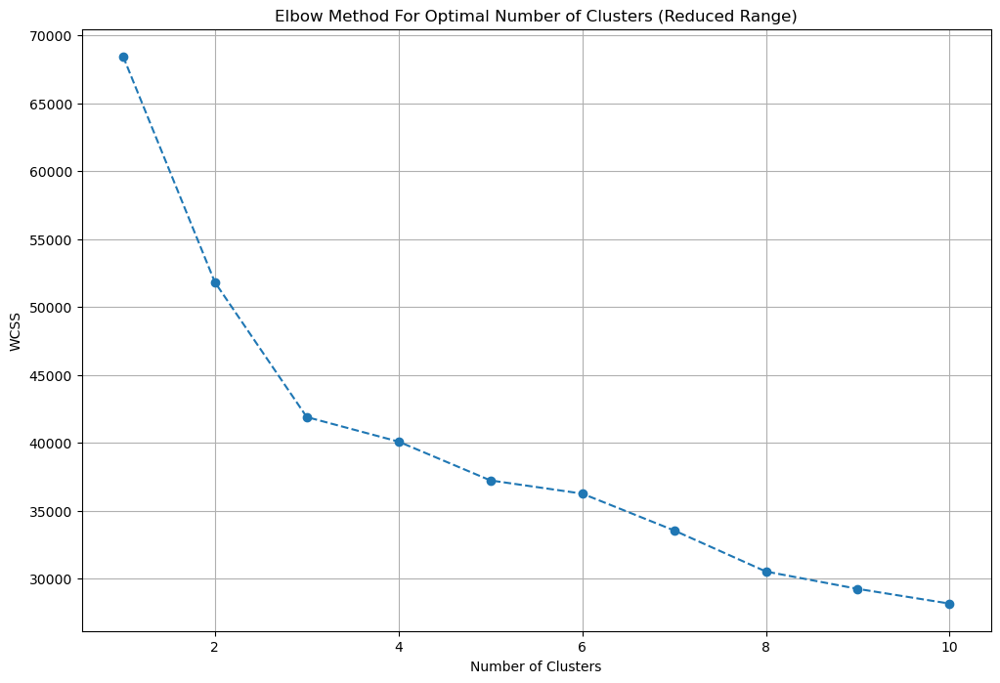

In [129]:
# Plot the results
plt.figure(figsize=(12, 8))
plt.plot(range(1,11), wcss_reduced, marker='o', linestyle='--')
plt.title('Elbow Method For Optimal Number of Clusters (Reduced Range)')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.grid(True)
plt.show()

In [130]:
n_clusters = 3

# Fit the KMeans model
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
kmeans.fit(scaled_data)

# Predict the cluster assignments for each row
cluster_assignments = kmeans.predict(scaled_data)

In [131]:
df = df.iloc[:,:-18]

In [132]:
df['furnishing_type'] = cluster_assignments

In [133]:
df.sample(5)[['furnishDetails','furnishing_type']]
# 0 -> unfurnished
# 1 -> semifurnished
# 2 -> furnished

,furnishDetails,furnishing_type
3661,"['16 Wardrobe', '26 Fan', '1 Exhaust Fan', '16 Geyser', '32 Light', '16 AC', '1 Modular Kitchen', '1 Chimney', 'No Bed', 'No Curtains', 'No Dining Table', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Washing Machine', 'No Water Purifier']",0
311,"['2 Wardrobe', '8 Light', '1 Modular Kitchen', 'No AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Fan', 'No Geyser', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Washing Machine', 'No Water Purifier']",1
3101,[],1
261,"['3 Fan', '15 Light', '1 Wardrobe', 'No AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Geyser', 'No Modular Kitchen', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Washing Machine', 'No Water Purifier']",1
1866,"['1 Light', 'No AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Fan', 'No Geyser', 'No Modular Kitchen', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']",1


## 5.features

In [135]:
df[["features"]]

,features
0,NaN
1,"['Piped-gas', 'Natural Light']"
2,"['Power Back-up', 'Lift(s)', 'Maintenance Staff', 'Park', 'Security Personnel']"
3,"['Security / Fire Alarm', 'Feng Shui / Vaastu Compliant', 'Intercom Facility', 'Lift(s)', 'Water purifier', 'High Ceiling Height', 'Maintenance Staff', 'Water Storage', 'Visitor Parking', 'Swimming Pool', 'Park', 'Natural Light', 'Internet/wi-fi connectivity', 'Shopping Centre', 'Fitness Centre / GYM', 'Club house / Community Center']"
4,"['Power Back-up', 'Feng Shui / Vaastu Compliant', 'Intercom Facility', 'Lift(s)', 'High Ceiling Height', 'Maintenance Staff', 'False Ceiling Lighting', 'Separate entry for servant room', 'No open drainage around', 'Swimming Pool', 'Park', 'Internet/wi-fi connectivity', 'Shopping Centre', 'Fitness Centre / GYM', 'Waste Disposal', 'Rain Water Harvesting', 'Club house / Community Center', 'Water softening plant']"
5,NaN
6,"['Feng Shui / Vaastu Compliant', 'Security / Fire Alarm', 'Intercom Facility', 'Lift(s)', 'Maintenance Staff', 'Swimming Pool', 'Water Storage', 'Park', 'Visitor Parking', 'Fitness Centre / GYM', 'Club house / Community Center']"
7,NaN
8,NaN
9,"['Feng Shui / Vaastu Compliant', 'Private Garden / Terrace', 'Maintenance Staff', 'Water Storage', 'Park', 'Visitor Parking', 'Waste Disposal', 'Rain Water Harvesting']"


In [136]:
df["features"].isnull().sum()

635

In [137]:
import pandas as pd
app_df = pd.read_csv("appartments.csv")
app_df.head(2)

,PropertyName,PropertySubName,NearbyLocations,LocationAdvantages,Link,PriceDetails,TopFacilities
0,Smartworld One DXP,"2, 3, 4 BHK Apartment in Sector 113, Gurgaon","['Bajghera Road', 'Palam Vihar Halt', 'DPSG Palam Vihar', 'Park Hospital', 'Gurgaon Railway Station']","{'Bajghera Road': '800 Meter', 'Palam Vihar Halt': '2.5 KM', 'DPSG Palam Vihar': '3.1 KM', 'Park Hospital': '3.1 KM', 'Gurgaon Railway Station': '4.9 KM', 'The NorthCap University': '5.4 KM', 'Dwarka Expy': '1.2 KM', 'Hyatt Place Gurgaon Udyog Vihar': '7.7 KM', 'Dwarka Sector 21, Metro Station': '7.2 KM', 'Pacific D21 Mall': '7.4 KM', 'Indira Gandhi International Airport': '14.7 KM', 'Hamoni Golf Camp': '6.2 KM', 'Fun N Food Waterpark': '8.8 KM', 'Accenture DDC5': '9 KM'}",https://www.99acres.com/smartworld-one-dxp-sector-113-gurgaon-npxid-r400415,"{'2 BHK': {'building_type': 'Apartment', 'area_type': 'Carpet Area', 'area': '1,370 sq.ft.', 'price-range': '₹ 2 - 2.4 Cr'}, '3 BHK': {'building_type': 'Apartment', 'area_type': 'Carpet Area', 'area': '1,850 - 2,050 sq.ft.', 'price-range': '₹ 2.25 - 3.59 Cr'}, '4 BHK': {'building_type': 'Apartment', 'area_type': 'Carpet Area', 'area': '2,600 sq.ft.', 'price-range': '₹ 3.24 - 4.56 Cr'}}","['Swimming Pool', 'Salon', 'Restaurant', 'Spa', 'Cafeteria', 'Sun Deck', '24x7 Security', 'Club House', 'Gated Community']"
1,M3M Crown,"3, 4 BHK Apartment in Sector 111, Gurgaon","['DPSG Palam Vihar Gurugram', 'The NorthCap University', 'Park Hospital, Palam Vihar', 'Pacific D21 Mall', 'Palam Vihar Halt Railway Station']","{'DPSG Palam Vihar Gurugram': '1.4 Km', 'The NorthCap University': '4.4 Km', 'Park Hospital, Palam Vihar': '1.4 Km', 'Pacific D21 Mall': '8.2 Km', 'Palam Vihar Halt Railway Station': '1.2 Km', 'Dwarka Sector 21 Metro Station': '8.1 Km', 'Dwarka Expressway': '450 m', 'Fun N Food Water Park': '8.1 Km', 'Indira Gandhi International Airport': '14.1 Km', 'Tau DeviLal Sports Complex': '11.2 Km', 'Hamoni Golf Camp': '5 Km', 'Hyatt Place': '6.1 Km', 'Altrade Business Centre': '11.2 Km'}",https://www.99acres.com/m3m-crown-sector-111-gurgaon-npxid-r404068,"{'3 BHK': {'building_type': 'Apartment', 'area_type': 'Super Built-up Area', 'area': '1,605 - 2,170 sq.ft.', 'price-range': '₹ 2.2 - 3.03 Cr'}, '4 BHK': {'building_type': 'Apartment', 'area_type': 'Super Built-up Area', 'area': '2,248 - 2,670 sq.ft.', 'price-range': '₹ 3.08 - 3.73 Cr'}}","['Bowling Alley', 'Mini Theatre', 'Manicured Garden', 'Swimming Pool', 'Flower Garden', 'Reading Lounge', 'Golf Course', 'Barbecue', 'Sauna']"


In [138]:
app_df["PropertyName"] = app_df["PropertyName"].str.lower()

In [139]:
app_df.isnull().sum()

PropertyName          0
PropertySubName       0
NearbyLocations       0
LocationAdvantages    0
Link                  0
PriceDetails          0
TopFacilities         0
dtype: int64

In [140]:
app_df.shape

(247, 7)

In [141]:
temp_df = df[df['features'].isnull()]

In [142]:
x = temp_df.merge(app_df,left_on='society',right_on='PropertyName',how='left')['TopFacilities']

In [143]:
df

,sector,property_type,society,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type
0,sector 95,flat,the roselia 2,0.45,6475.0,695.00,Built Up area: 695 (64.57 sq.m.)Carpet area: 595 sq.ft. (55.28 sq.m.),2,2,2,not available,19.0,North,Undefined,NaN,NaN,NaN,NaN,695.000000,595.000000,0,0,0,0,0,1
1,sector 78,flat,umang monsoon breeze,1.20,6493.0,1848.00,Super Built up area 2250(209.03 sq.m.)Carpet area: 1848 sq.ft. (171.68 sq.m.),3,3,2,pooja room,8.0,Na,Moderately New Property,"['Proposed Metro Station', 'Mahapal Shing', 'National Highway 8', 'IGD Primary Health Care', 'HDFC Bank', 'PCL Logistics', 'JW Mariott']","['1 Water Purifier', '1 Fridge', '5 Fan', '1 Exhaust Fan', '1 Dining Table', '3 Geyser', '1 Stove', '12 Light', '1 Modular Kitchen', '1 Chimney', '3 Wardrobe', '3 Bed', '1 Sofa', '1 Washing Machine', '1 Microwave', 'No AC', 'No Curtains', 'No TV']","['Piped-gas', 'Natural Light']",2250.00,NaN,1848.000000,0,0,0,1,0,2
2,manesar,flat,hsiidc sidco aravali,0.91,3516.0,2588.00,Super Built up area 2588(240.43 sq.m.)Built Up area: 1900 sq.ft. (176.52 sq.m.),3,3,3+,servant room,8.0,East,Moderately New Property,"['Pooja Clinic', 'Dr. Sahil Clinic', 'Prakash Hospital', 'Shri Rade Clinic', 'Yadav Dental & Eye Care', 'Dental Hospital', 'Petrol pump Maitri motors', 'Petrol Pump', 'Petrol Pump Indian Oil', ""McDonald's"", ""McDonald's"", 'Rao Dhaba']","['6 Fan', '6 Light', 'No AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Geyser', 'No Modular Kitchen', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']","['Power Back-up', 'Lift(s)', 'Maintenance Staff', 'Park', 'Security Personnel']",2588.00,1900.000000,NaN,1,0,0,0,0,1
3,sector 108,flat,sobha city,3.35,13266.0,2525.00,Super Built up area 2072.9(192.58 sq.m.),3,4,2,not available,19.0,Na,New Property,"['Dwarka Sector 21', 'Dwarka Expressway', 'Vasant Kunj', 'The Shikshiyan School', 'The NorthCap University', 'Rions Hospital', 'IGI Airport', 'Gurgaon', 'WTC Plaza', 'Luxus Haritma Resort', 'Fun N Food WaterPark', 'BSF Golf Course', 'Nehru Stadium']",NaN,"['Security / Fire Alarm', 'Feng Shui / Vaastu Compliant', 'Intercom Facility', 'Lift(s)', 'Water purifier', 'High Ceiling Height', 'Maintenance Staff', 'Water Storage', 'Visitor Parking', 'Swimming Pool', 'Park', 'Natural Light', 'Internet/wi-fi connectivity', 'Shopping Centre', 'Fitness Centre / GYM', 'Club house / Community Center']",2072.90,NaN,NaN,0,0,0,0,0,1
4,sector 108,flat,sobha city,1.90,13758.0,1381.00,Super Built up area 1381(128.3 sq.m.),2,2,2,not available,8.0,East,Relatively new property,"['Dwarka Sector 21', 'Dwarka Expressway', 'Vasant Kunj', 'The Shikshiyan School', 'The NorthCap University', 'Rions Hospital', 'IGI Airport', 'Gurgaon', 'WTC Plaza', 'Luxus Haritma Resort', 'Fun N Food WaterPark', 'BSF Golf Course', 'Nehru Stadium']",[],"['Power Back-up', 'Feng Shui / Vaastu Compliant', 'Intercom Facility', 'Lift(s)', 'High Ceiling Height', 'Maintenance Staff', 'False Ceiling Lighting', 'Separate entry for servant room', 'No open drainage around', 'Swimming Pool', 'Park', 'Internet/wi-fi connectivity', 'Shopping Centre', 'Fitness Centre / GYM', 'Waste Disposal', 'Rain Water Harvesting', 'Club house / Community Center', 'Water softening plant']",1381.00,NaN,NaN,0,0,0,0,0,1
5,sector 65,flat,m3m heights,2.15,15003.0,1433.00,Built Up area: 1433 (133.13 sq.m.),2,2,3+,not available,28.0,East,Undefined,"['Rapid Metro Sector 56', 'M3m 65th Avenue Mall', 'Golf Course Extension Road', 'Gurgaon - Delhi Expy', 'DPS International School', 'DPG Institute of Technology', 'Park Hospital', 'Indira Gandhi International Airport', 'Lemon Tree Hotel', 'SkyJumper Trampoline Park', 'PVR Drive in Theatre']","['1 Light', 'No AC', 'No Bed

In [144]:
df.loc[temp_df.index,'features'] = x.values

In [145]:
df['features'].isnull().sum()

481

In [146]:
from sklearn.preprocessing import MultiLabelBinarizer
import ast

In [147]:
# Convert the string representation of lists in the 'features' column to actual lists
df['features_list'] = df['features'].apply(lambda x: ast.literal_eval(x) if pd.notnull(x) and x.startswith('[') else [])

# Use MultiLabelBinarizer to convert the features list into a binary matrix
mlb = MultiLabelBinarizer()
features_binary_matrix = mlb.fit_transform(df['features_list'])

# Convert the binary matrix into a DataFrame
features_binary_df = pd.DataFrame(features_binary_matrix, columns=mlb.classes_)

In [148]:
features_binary_df.sample(5)

,24/7 Power Backup,24/7 Water Supply,24x7 Security,ATM,Aerobics Centre,Air Hockey,Airy Rooms,Amphitheatre,Automated Car Wash,Badminton Court,Bank Attached Property,Banquet Hall,Bar/Chill-Out Lounge,Barbecue,Basketball Court,Beach Volley Ball Court,Billiards,Bowling Alley,Bus Shelter,Business Lounge,CCTV Camera Security,Cafeteria,Car Parking,Car wash area,Card Room,Centrally Air Conditioned,Changing Area,Children's Play Area,Cigar Lounge,Clinic,Club House,Club house / Community Center,Community Hall,Concierge Service,Conference room,Creche/Day care,Cricket Pitch,Doctor on Call,Earthquake Resistant,Entrance Lobby,False Ceiling Lighting,Feng Shui / Vaastu Compliant,Fire Fighting Systems,Fitness Centre / GYM,Flower Garden,Food Court,Foosball,Football,Fountain,Gated Community,Gazebo,Golf Course,Grocery Shop,Gymnasium,High Ceiling Height,High Speed Elevators,Infinity Pool,Intercom Facility,Internal Street Lights,Internet/wi-fi connectivity,Jacuzzi,Jogging Track,Landscape Garden,Laundry,Lawn Tennis Court,Library,Lift(s),Lounge,Low Density Society,Maintenance Staff,Manicured Garden,Medical Centre,Milk Booth,Mini Theatre,Multipurpose Court,Multipurpose Hall,Natural Light,Natural Pond,No open drainage around,Park,Party Lawn,Pergola,Piped Gas,Piped-gas,Pool Table,Power Back up Lift,Power Back-up,Private Garden / Terrace,Property Staff,RO System,Rain Water Harvesting,Reading Lounge,Recently Renovated,Reflexology Park,Restaurant,Salon,Sauna,School,Security / Fire Alarm,Security Personnel,Separate entry for servant room,Sewage Treatment Plant,Shopping Centre,Skating Rink,Solar Lighting,Solar Water Heating,Spa,Spacious Interiors,Squash Court,Steam Room,Sun Deck,Swimming Pool,Temple,Terrace Garden,Theatre,Toddler Pool,Valet Parking,Vastu Compliant,Video Door Security,Visitor Parking,Visitors Parking,Volley Ball Court,Waiting Lounge,Waste Disposal,Water Softener Plant,Water Storage,Water purifier,Water softening plant,Wi-Fi Connectivity,Yoga/Meditation Area
102,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1643,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,1,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,1,1,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1,1,0,0
1112,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0
953,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0
238,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [149]:
wcss_reduced = []

for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', random_state=42)
    kmeans.fit(features_binary_df)
    wcss_reduced.append(kmeans.inertia_)

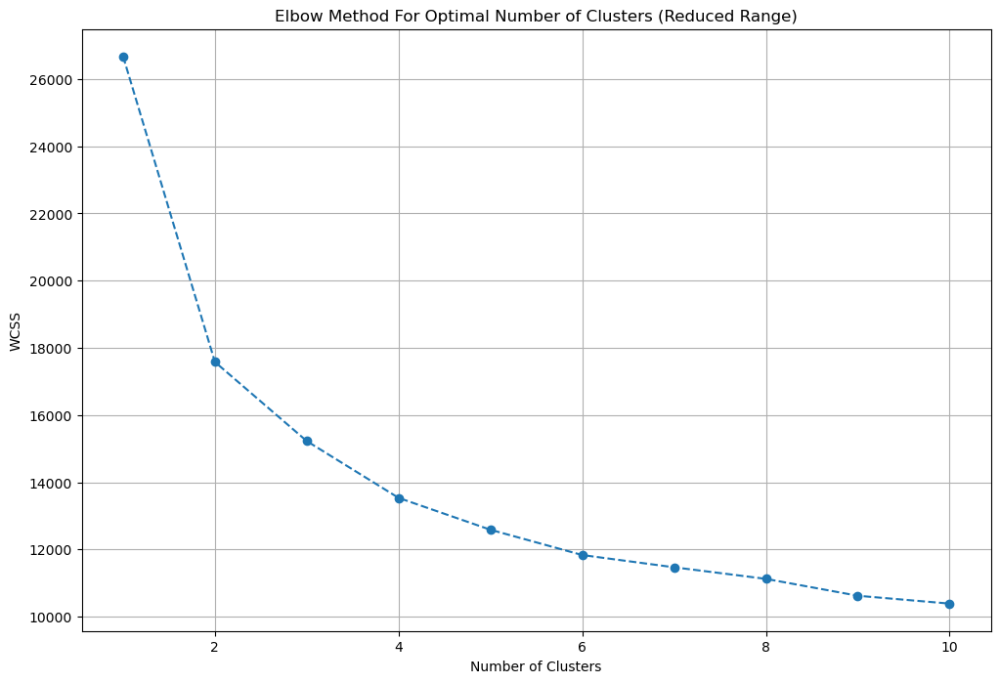

In [150]:
# Plot the results
plt.figure(figsize=(12, 8))
plt.plot(range(1,11), wcss_reduced, marker='o', linestyle='--')
plt.title('Elbow Method For Optimal Number of Clusters (Reduced Range)')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.grid(True)
plt.show()

In [151]:
# Define the weights for each feature as provided
# Assigning weights based on perceived luxury contribution
weights = {
    '24/7 Power Backup': 8,
    '24/7 Water Supply': 4,
    '24x7 Security': 7,
    'ATM': 4,
    'Aerobics Centre': 6,
    'Airy Rooms': 8,
    'Amphitheatre': 7,
    'Badminton Court': 7,
    'Banquet Hall': 8,
    'Bar/Chill-Out Lounge': 9,
    'Barbecue': 7,
    'Basketball Court': 7,
    'Billiards': 7,
    'Bowling Alley': 8,
    'Business Lounge': 9,
    'CCTV Camera Security': 8,
    'Cafeteria': 6,
    'Car Parking': 6,
    'Card Room': 6,
    'Centrally Air Conditioned': 9,
    'Changing Area': 6,
    "Children's Play Area": 7,
    'Cigar Lounge': 9,
    'Clinic': 5,
    'Club House': 9,
    'Concierge Service': 9,
    'Conference room': 8,
    'Creche/Day care': 7,
    'Cricket Pitch': 7,
    'Doctor on Call': 6,
    'Earthquake Resistant': 5,
    'Entrance Lobby': 7,
    'False Ceiling Lighting': 6,
    'Feng Shui / Vaastu Compliant': 5,
    'Fire Fighting Systems': 8,
    'Fitness Centre / GYM': 8,
    'Flower Garden': 7,
    'Food Court': 6,
    'Foosball': 5,
    'Football': 7,
    'Fountain': 7,
    'Gated Community': 7,
    'Golf Course': 10,
    'Grocery Shop': 6,
    'Gymnasium': 8,
    'High Ceiling Height': 8,
    'High Speed Elevators': 8,
    'Infinity Pool': 9,
    'Intercom Facility': 7,
    'Internal Street Lights': 6,
    'Internet/wi-fi connectivity': 7,
    'Jacuzzi': 9,
    'Jogging Track': 7,
    'Landscape Garden': 8,
    'Laundry': 6,
    'Lawn Tennis Court': 8,
    'Library': 8,
    'Lounge': 8,
    'Low Density Society': 7,
    'Maintenance Staff': 6,
    'Manicured Garden': 7,
    'Medical Centre': 5,
    'Milk Booth': 4,
    'Mini Theatre': 9,
    'Multipurpose Court': 7,
    'Multipurpose Hall': 7,
    'Natural Light': 8,
    'Natural Pond': 7,
    'Park': 8,
    'Party Lawn': 8,
    'Piped Gas': 7,
    'Pool Table': 7,
    'Power Back up Lift': 8,
    'Private Garden / Terrace': 9,
    'Property Staff': 7,
    'RO System': 7,
    'Rain Water Harvesting': 7,
    'Reading Lounge': 8,
    'Restaurant': 8,
    'Salon': 8,
    'Sauna': 9,
    'Security / Fire Alarm': 9,
    'Security Personnel': 9,
    'Separate entry for servant room': 8,
    'Sewage Treatment Plant': 6,
    'Shopping Centre': 7,
    'Skating Rink': 7,
    'Solar Lighting': 6,
    'Solar Water Heating': 7,
    'Spa': 9,
    'Spacious Interiors': 9,
    'Squash Court': 8,
    'Steam Room': 9,
    'Sun Deck': 8,
    'Swimming Pool': 8,
    'Temple': 5,
    'Theatre': 9,
    'Toddler Pool': 7,
    'Valet Parking': 9,
    'Video Door Security': 9,
    'Visitor Parking': 7,
    'Water Softener Plant': 7,
    'Water Storage': 7,
    'Water purifier': 7,
    'Yoga/Meditation Area': 7
}
# Calculate luxury score for each row
luxury_score = features_binary_df[list(weights.keys())].multiply(list(weights.values())).sum(axis=1)

In [152]:
df['luxury_score'] = luxury_score

In [153]:
df.head()

,sector,property_type,society,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type,features_list,luxury_score
0,sector 95,flat,the roselia 2,0.45,6475.0,695.0,Built Up area: 695 (64.57 sq.m.)Carpet area: 595 sq.ft. (55.28 sq.m.),2,2,2,not available,19.0,North,Undefined,NaN,NaN,NaN,NaN,695.0,595.0,0,0,0,0,0,1,[],0
1,sector 78,flat,umang monsoon breeze,1.20,6493.0,1848.0,Super Built up area 2250(209.03 sq.m.)Carpet area: 1848 sq.ft. (171.68 sq.m.),3,3,2,pooja room,8.0,Na,Moderately New Property,"['Proposed Metro Station', 'Mahapal Shing', 'National Highway 8', 'IGD Primary Health Care', 'HDFC Bank', 'PCL Logistics', 'JW Mariott']","['1 Water Purifier', '1 Fridge', '5 Fan', '1 Exhaust Fan', '1 Dining Table', '3 Geyser', '1 Stove', '12 Light', '1 Modular Kitchen', '1 Chimney', '3 Wardrobe', '3 Bed', '1 Sofa', '1 Washing Machine', '1 Microwave', 'No AC', 'No Curtains', 'No TV']","['Piped-gas', 'Natural Light']",2250.0,NaN,1848.0,0,0,0,1,0,2,"[Piped-gas, Natural Light]",8
2,manesar,flat,hsiidc sidco aravali,0.91,3516.0,2588.0,Super Built up area 2588(240.43 sq.m.)Built Up area: 1900 sq.ft. (176.52 sq.m.),3,3,3+,servant room,8.0,East,Moderately New Property,"['Pooja Clinic', 'Dr. Sahil Clinic', 'Prakash Hospital', 'Shri Rade Clinic', 'Yadav Dental & Eye Care', 'Dental Hospital', 'Petrol pump Maitri motors', 'Petrol Pump', 'Petrol Pump Indian Oil', ""McDonald's"", ""McDonald's"", 'Rao Dhaba']","['6 Fan', '6 Light', 'No AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Geyser', 'No Modular Kitchen', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']","['Power Back-up', 'Lift(s)', 'Maintenance Staff', 'Park', 'Security Personnel']",2588.0,1900.0,NaN,1,0,0,0,0,1,"[Power Back-up, Lift(s), Maintenance Staff, Park, Security Personnel]",23
3,sector 108,flat,sobha city,3.35,13266.0,2525.0,Super Built up area 2072.9(192.58 sq.m.),3,4,2,not available,19.0,Na,New Property,"['Dwarka Sector 21', 'Dwarka Expressway', 'Vasant Kunj', 'The Shikshiyan School', 'The NorthCap University', 'Rions Hospital', 'IGI Airport', 'Gurgaon', 'WTC Plaza', 'Luxus Haritma Resort', 'Fun N Food WaterPark', 'BSF Golf Course', 'Nehru Stadium']",NaN,"['Security / Fire Alarm', 'Feng Shui / Vaastu Compliant', 'Intercom Facility', 'Lift(s)', 'Water purifier', 'High Ceiling Height', 'Maintenance Staff', 'Water Storage', 'Visitor Parking', 'Swimming Pool', 'Park', 'Natural Light', 'Internet/wi-fi connectivity', 'Shopping Centre', 'Fitness Centre / GYM', 'Club house / Community Center']",2072.9,NaN,NaN,0,0,0,0,0,1,"[Security / Fire Alarm, Feng Shui / Vaastu Compliant, Intercom Facility, Lift(s), Water purifier, High Ceiling Height, Maintenance Staff, Water Storage, Visitor Parking, Swimming Pool, Park, Natural Light, Internet/wi-fi connectivity, Shopping Centre, Fitness Centre / GYM, Club house / Community Center]",102
4,sector 108,flat,sobha city,1.90,13758.0,1381.0,Super Built up area 1381(128.3 sq.m.),2,2,2,not available,8.0,East,Relatively new property,"['Dwarka Sector 21', 'Dwarka Expressway', 'Vasant Kunj', 'The Shikshiyan School', 'The NorthCap University', 'Rions Hospital', 'IGI Airport', 'Gurgaon', 'WTC Plaza', 'Luxus Haritma Resort', 'Fun N Food WaterPark', 'BSF Golf Course', 'Nehru Stadium']",[],"['Power Back-up', 'Feng Shui / Vaastu Compliant', 'Intercom Facility', 'Lift(s)', 'High Ceiling Height', 'Maintenance Staff', 'False Ceiling Lighting', 'Separate entry for servant room', 'No open drainage around', 'Swimming Pool', 'Park', 'Internet/wi-fi connectivity', 'Shopping Centre', 'Fitness Centre / GYM', 'Waste Disposal', 'Rain Water Harvesting', 'Club house / Community Center', 'Water softening plant']",1381.0,NaN,NaN,0,0,0,0,0,1,"[Power Back-up, Feng Shui / 

In [154]:

# cols to drop -> nearbyLocations,furnishDetails, features,features_list, additionalRoom
df.drop(columns=['nearbyLocations','furnishDetails','features','features_list','additionalRoom'],inplace=True)

In [155]:
df.sample(3)

,sector,property_type,society,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,floorNum,facing,agePossession,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score
636,gwal pahari,flat,krrish provence estate,5.50,9482.0,5800.0,Super Built up area 5800(538.84 sq.m.),4,5,3+,11.0,East,New Property,5800.0,NaN,NaN,1,1,0,1,0,1,151
2669,sector 76,flat,whiteland blissville,1.90,11363.0,1672.0,Super Built up area 1672(155.33 sq.m.),3,3,2,0.0,Na,Under Construction,1672.0,NaN,NaN,0,0,0,0,0,1,61
587,sector 79,flat,godrej,1.34,8524.0,1572.0,Super Built up area 1572(146.04 sq.m.),2,2,3,2.0,North-West,Relatively new property,1572.0,NaN,NaN,0,1,0,0,0,1,158


In [156]:
df.shape

(3803, 23)

In [157]:
df.to_csv('gurgaon_properties_cleaned_v2.csv',index=False)